# Mouse Movement Plot - Temizlenmiş Veri ile
Bu notebook, CSV dosyasındaki geçersiz `x` ve `y` sütunlarını temizler ve sadece geçerli satırların grafiklerini çizer.

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import ast

In [4]:
# CSV'yi oku (yolu ihtiyacına göre değiştir)
csv_path = "C:\\store\\git\\km-stat-activity\\data\\real\\real_activity_log.csv"
df = pd.read_csv(csv_path)

In [5]:
# Belirli bir kullanıcıyı seç
profile_guid = "002e8f20-d5c2-4153-b1d0-9e1332549ac6"
df_user = df[df['profile_guid'] == profile_guid].copy()

In [8]:
# Boş veya set gibi hatalı değerleri filtrele
def fix_set_format(s):
    if isinstance(s, str) and s.startswith("{") and s.endswith("}"):
        return "[" + s.strip("{}") + "]"
    return s

# Temizleme işlemi
df_user['x'] = df_user['x'].apply(fix_set_format)
df_user['y'] = df_user['y'].apply(fix_set_format)
df_user = df_user[df_user['x'].notna() & df_user['y'].notna()]
df_user = df_user[df_user['x'].str.startswith('[') & df_user['y'].str.startswith('[')]

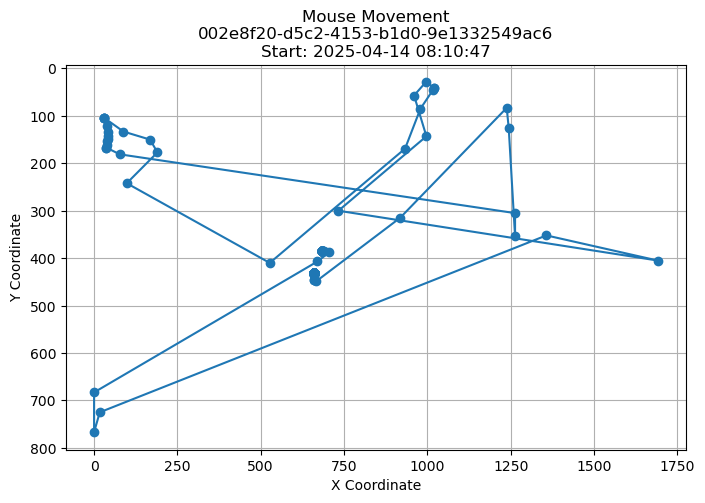

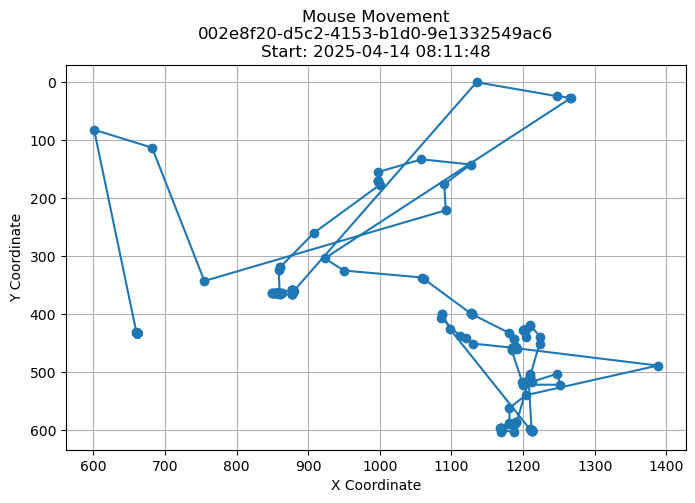

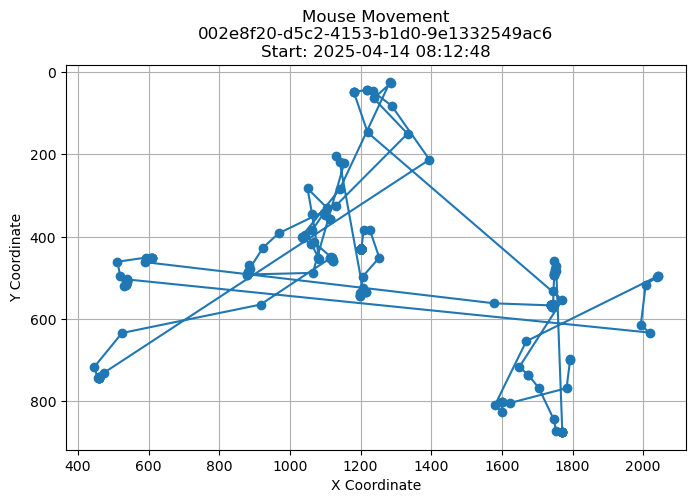

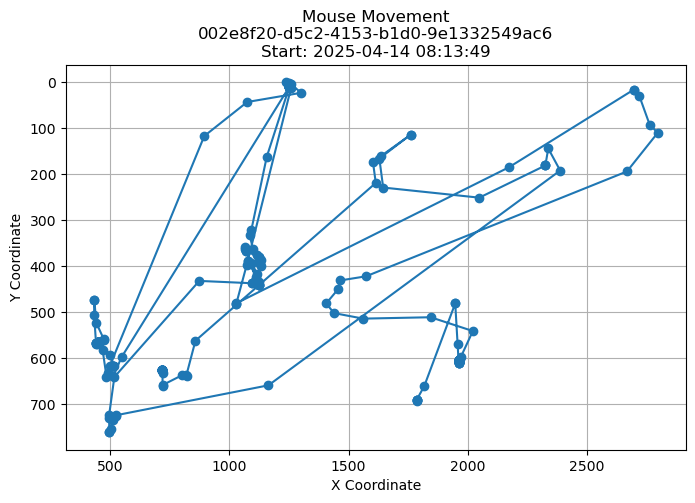

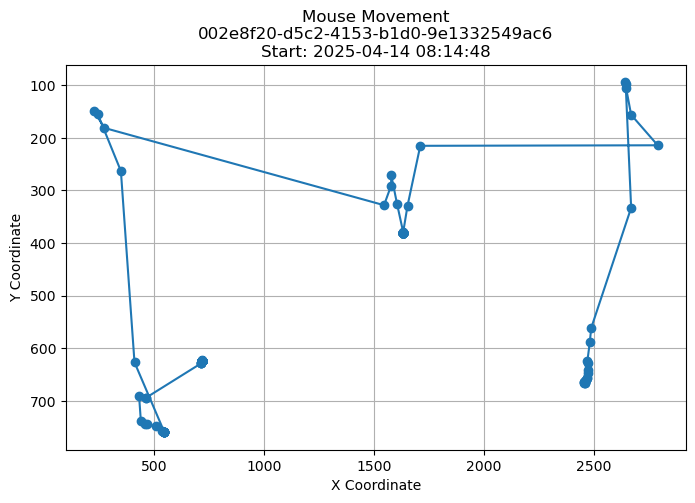

...

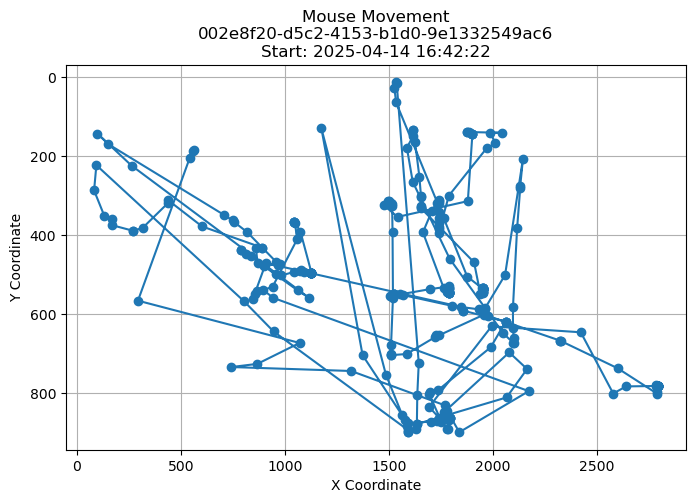

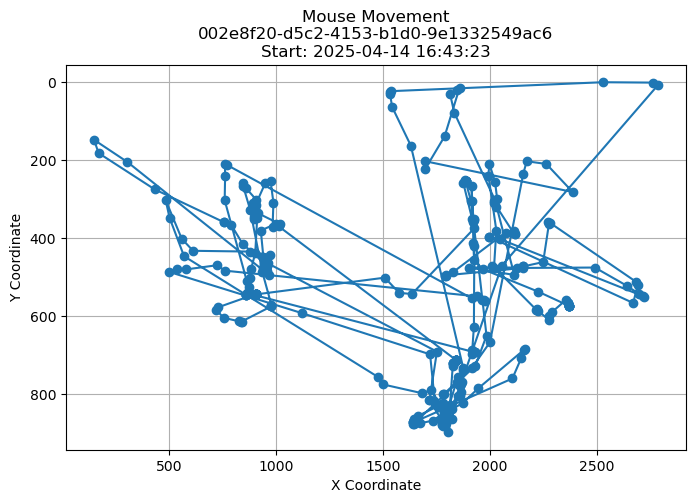

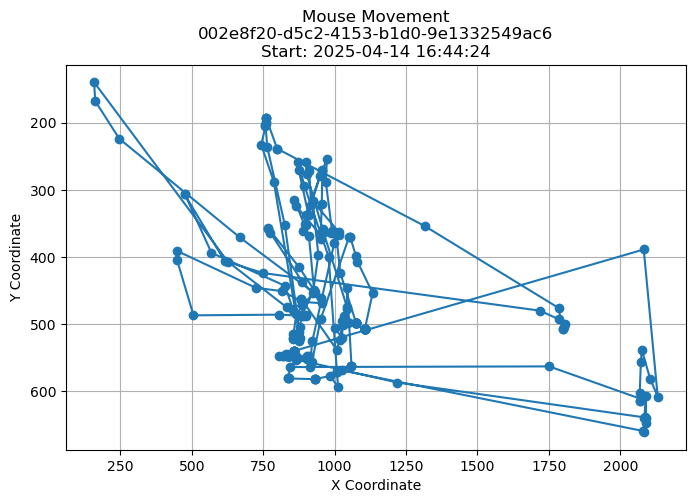

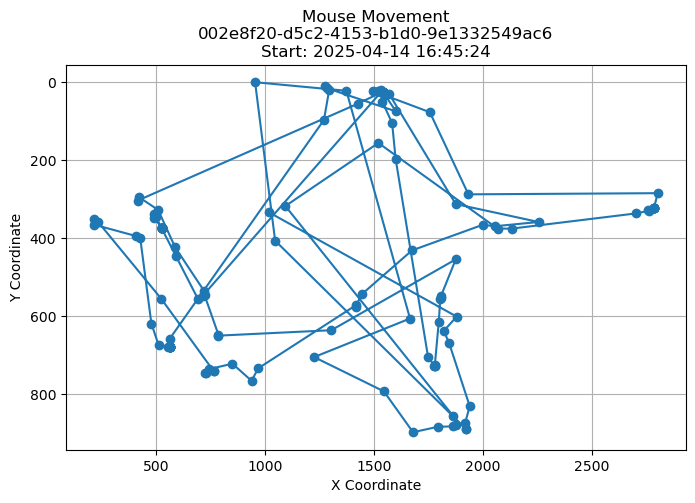

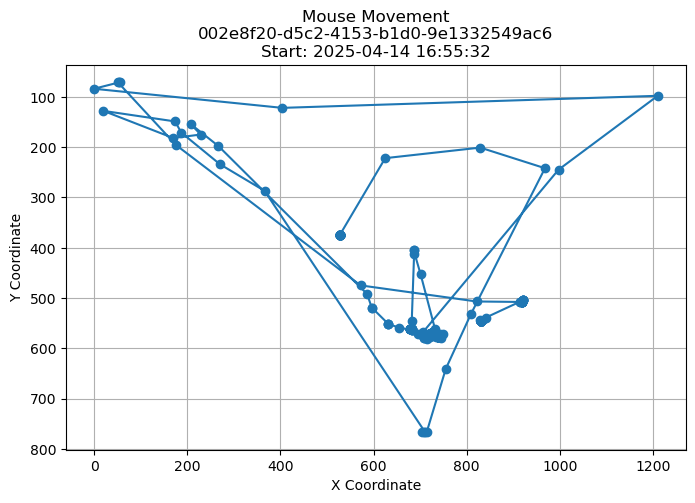

In [10]:
# Geçerli satırları çiz
for idx, row in df_user.iterrows():
    try:
        x_coords = ast.literal_eval(row['x'])
        y_coords = ast.literal_eval(row['y'])

        if len(x_coords) != len(y_coords):
            raise ValueError("Uzunluk eşleşmiyor")

        plt.figure(figsize=(8, 5))
        plt.plot(x_coords, y_coords, marker='o', linestyle='-')
        plt.title(f"Mouse Movement\n{profile_guid}\nStart: {row['start_date_time']}")
        plt.xlabel("X Coordinate")
        plt.ylabel("Y Coordinate")
        plt.gca().invert_yaxis()
        plt.grid(True)
        plt.show()
    
    except Exception as e:
        print(f"Satır {idx} atlandı: {e}")

In [14]:
!jupyter nbconvert --to html mouse_movement_clean_plot.ipynb


[NbConvertApp] Converting notebook mouse_movement_clean_plot.ipynb to html
[NbConvertApp] WARNING | Alternative text is missing on 361 image(s).
[NbConvertApp] Writing 34574432 bytes to mouse_movement_clean_plot.html
